In [1]:
import os
import json
import pandas as pd
import numpy as np
import re
import ast
from collections import Counter
import nltk
nltk.download('punkt')
from nltk.tokenize import word_tokenize
from scipy.stats import entropy
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler
import matplotlib.pyplot as plt
import seaborn as sns


# Obtener la ruta del archivo JSON en la carpeta actual
json_file = os.path.abspath(os.path.join(os.getcwd(), os.pardir))+"\\config\\config.json"
# Leer el archivo JSON
with open(json_file, 'r') as f:
    cfg = json.load(f)

# Carga el conjunto de datos en un DataFrame de pandas
df = pd.read_csv(cfg['root_folder'] + "/data/datos_dep.csv")
data = df


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\marcorhe\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
c:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3444: DtypeWarning: Columns (129) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [2]:
#Funciones de automatizaciones para facilitar descriptivo:

def tipo_variables(datos,ncat):
    for i in datos.columns:
        #ids sugeridos
        if(datos[i].nunique() == datos.shape[0]): ids.append(i)
        # Nulos
        if(all(datos[i].isnull())): omitir.append(i)
        # Si los datos que hay en la columna son siempre el mismo, se da una advertencia
        if(datos[i].nunique() == 1): omitir.append(i)        

    data = datos.drop(ids, axis=1)
    data = datos.drop(omitir, axis=1)

    ##
    # Identificar tipo variables
    ##

    tipos={}
    for i in range(0,len(data.dtypes.value_counts())):
        tipo_dato = data.dtypes.value_counts().index[i].kind
        tipoj=[]
        for j in range(0,data.shape[1]):
            if(data.dtypes[j].kind==tipo_dato):
                tipoj.append(data.dtypes.index[j])
        tipos[tipo_dato]=tipoj
    '''
    if not np.issubdtype(df_analysis[col].dtype, np.number):
                print(f'La variable {cb}{col}{cc} NO es numerica')
                continue
    '''
    numeric = tipos.get('i',[]) + tipos.get('f',[]) + tipos.get('u',[])
    c = data[numeric].nunique()
    categoric2 = c[c<=ncat].axes[0].tolist()    
    for i in categoric2: numeric.remove(i)
    categoric =  categoric2 + tipos.get('b',[])+tipos.get('c',[])+tipos.get('m',[])+tipos.get('M',[])+tipos.get('O',[])+tipos.get('S',[])+tipos.get('U',[])+tipos.get('V',[])
    datos[categoric2] = datos[categoric2].astype('str')

    return datos, numeric, categoric, omitir, ids

def descriptivo_num(datos,col,flag_zeros):

    # Hallamos los porcentajes de zeros y nulos de la base, correspondiente al despoblamiento.
    perc_zeros =  round((datos[datos[col] == 0].shape[0])*100/datos.shape[0], 2)
    perc_nulls = round((datos[col].shape[0] - datos[col].dropna().shape[0])*100/datos.shape[0], 2)

    # Hallamos el número de valores que no son cero y que tampoco son nulos.
    n_rows_clean = datos[~datos[col].isnull() & (datos[col] != 0)].shape[0]

    if flag_zeros == 1 and datos[[col]].nunique().values[0] != 2: 
        datos = datos[datos[col] != 0]

    # Calculamos el percentil 95 para gráficar correctamente el boxplot, ya que los outliers arruinan la gráfica.
    q95 = datos.quantile(q = 0.95).values[0] if any(datos[col].notnull()) else float('inf')

    # Contamos el número de outliers existentes (valores por encima del 95% de los datos).
    n_outliers = datos[datos[col] > q95].size

    # Creamos un data frame para almacenar las estadísticas
    df_other = pd.DataFrame(["{:0.2f}%".format(perc_zeros),"{:0.2f}%".format(perc_nulls), "{:,}".format(n_rows_clean), "{:,}".format(n_outliers)], 
                            index = ['ceros%', 'nulos%','total', 'outliers'],
                            columns=[col])

    # Calculamos las estadísticas de la columna analizada
    df_stats = np.round(datos[col].describe(percentiles = quantiles, include='all'),2).map("{:,}".format)
    # Eliminamos la columna count que se encuentra repetida
    df_stats = df_stats.drop(["count"])

    # Concatenamos los dos DataFrame de estadísticas
    df_stats = df_other.append(pd.DataFrame(df_stats))
    
    
    # Removemos los datos que se encuentren por encima del 99% de los datos para una mejor visualización de las gráficas.
    q99 = datos.quantile(q = 0.99).values[0] if any(datos[col].notnull()) else float('inf')
    datos = datos[datos[col] <= q99]

    # Creamos la figura y los axes donde se graficará.
    fig, axs = plt.subplots(1,2, figsize = (25, 9.6)) 

    # Agregamos titulo a la figura.
    fig.suptitle(col.upper().replace("_", " "), fontsize = 20)


    # Graficamos la función de densidad de probabilidad.
    plt.axes(axs[0])
    sns.set(style = "whitegrid")
    sns.kdeplot(datos[col], shade=True, color="r", legend=False)
    plt.ylabel("Density", fontsize = 16)
    plt.xlabel(col.replace("_", " "), fontsize = 16)

    # Graficamos el boxplot.
    plt.axes(axs[1])
    plt.grid(False)
    plt.boxplot(datos[col], widths = 0.09)
    plt.ylabel(col)

    # Convertimos las estadísticas en string con separación de miles para mejor visualización en la gráfica.
    df_stats_plot = df_stats[col]

    the_table = table(axs[1], df_stats_plot, loc='upper right', colWidths=[0.15, 0.3, 0.1], cellLoc = 'center')
    the_table.auto_set_font_size(False)
    the_table.set_fontsize(14)
    the_table.scale(2, 2)
    plt.ylabel(col.replace("_", " "), fontsize = 16)
    
    return df_stats



def descriptivo_cat(datos,col,flag_zeros):
    # Hallamos los porcentajes de zeros y nulos de la base, correspondiente al despoblamiento.
    perc_zeros =  round((datos[datos[col] == "0"].shape[0])*100/datos.shape[0], 2)
    perc_nulls = round((datos[col].shape[0] - datos[col].dropna().shape[0])*100/datos.shape[0], 2)

    # Hallamos el número de valores que no son cero y que tampoco son nulos.
    n_rows_clean = datos[~datos[col].isnull() & (datos[col] != "0")].shape[0]

    if flag_zeros == 1 and datos[[col]].nunique().values[0] != 2: 
        datos = datos[datos[col] != "0"]
    
    categorias = 100 * dat[col].value_counts() / len(dat[col])
    unicos = dat[col].nunique()
    
    # Convertimos las estadísticas en string con separación de miles para mejor visualización en la gráfica.
    df_stats_plot = pd.DataFrame(["{:0.2f}%".format(perc_zeros),"{:0.2f}%".format(perc_nulls), "{:,}".format(n_rows_clean),"{:,}".format(unicos)], 
                            index = ['ceros%', 'nulos%','total', 'categorias'], 
                            columns = [col])
      # Creamos la figura y los axes donde se graficará.
    fig, axs = plt.subplots(1,3, figsize = (25, 9.6)) 

    # Agregamos titulo a la figura.
    fig.suptitle(col.upper().replace("_", " "), fontsize = 20)
 
    the_table = table(axs[1], df_stats_plot, loc='center', colWidths=[0.15, 0.3, 0.1], cellLoc = 'center')
    the_table.auto_set_font_size(False)
    the_table.set_fontsize(14)
    the_table.scale(2, 2)
    plt.ylabel(col.replace("_", " "), fontsize = 16)
    axs[0].axis("off") 
    df_stats_plot = categorias.map(lambda x: "{:0.2f}%".format(x))

    the_table = table(axs[0], df_stats_plot, loc='upper right', colWidths=[0.15, 0.3, 0.1], cellLoc = 'center')
    the_table.auto_set_font_size(False)
    the_table.set_fontsize(14)
    the_table.scale(2, 2)
    plt.ylabel(col.replace("_", " "), fontsize = 16)
    axs[1].axis("off") 

    #graficos categoricos
    plt.axes(axs[2])
    ax = sns.countplot(y=col, data=datos,order = datos[col].value_counts().index)
    plt.title(col)
    plt.xlabel('%')
    total = len(datos[col])
    for p in ax.patches:
            percentage = '{:.2f}%'.format(100 * p.get_width()/total)
            x = p.get_x() + p.get_width() + 0.02
            y = p.get_y() + p.get_height()/2
            ax.annotate(percentage, (x, y))

    return categorias
      


def descriptivo_inicial(datos,numeric,categoric):

    # general
    datos.head(3)
    datos.info()
    datos.describe()
    dat[numeric].skew()
    dat[numeric].kurt()
    correlaciones = dat[numeric].corr()
    fig_size = (25,15)
    fig, ax = plt.subplots(figsize = fig_size)
    sns.heatmap(correlaciones, annot=True, fmt='.4f', 
            cmap=plt.get_cmap('coolwarm'), cbar=False, ax=ax)

    for i in numeric:
        descriptivo_num(datos,i,zeros)
    for i in categoric:
        descriptivo_cat(datos,i,zeros)      

In [7]:
ids = []
omitir = []
data, num,cat,omit,id = tipo_variables(df,10)
dat=data

In [4]:
#identificadoras mal calculadas se corrige
id = [column for column in data.columns if 'id' in column.lower()]
num = [column for column in num if 'id' not in column.lower() and 'return' not in column.lower()]
cat = [column for column in cat if 'id' not in column.lower()]
cat.append('returnValue')

In [10]:
omit

['hostName', 'evil']

In [8]:
id

['timestamp',
 'dif_time_user',
 'dif_var_time_user',
 'dif_time_pprocess',
 'dif_time_user_ip',
 'dif_var_time_user_ip',
 'timestamp.1']

In [9]:
num

['processId',
 'parentProcessId',
 'eventId',
 'count_event',
 'count_process',
 'count_pprocess',
 'count_user_event',
 'count_user_processn',
 'count_user_process',
 'count_user_pprocess',
 'count_user_process_pprocess',
 'count_event_process',
 'count_event_pprocess',
 'count_event_process_pprocess',
 'count_process_pprocess',
 'count_user_event_process_pprocess',
 'count_user_ip',
 'timestamp',
 'min_probability_user_namearg',
 'max_probability_user_namearg',
 'sum_probability_user_namearg',
 'mean_probability_user_namearg',
 'total_probability_user_valuearg',
 'mean_probability_user_valuearg',
 'min_probability_user_valuearg',
 'mean_min_probability_user_valuearg',
 'max_probability_user_valuearg',
 'mean_max_probability_user_valuearg',
 'perc_user',
 'perc_event',
 'perc_process',
 'perc_pprocess',
 'perc_user_event',
 'perc_user_process',
 'perc_user_pprocess',
 'perc_user_process_pprocess',
 'perc_event_process',
 'perc_event_pprocess',
 'perc_event_process_pprocess',
 'perc_pr

In [609]:
cat

['argsNum',
 'sus',
 'processName',
 'eventName',
 'args',
 'user-agent',
 'ip',
 'returnValue']

In [610]:
# eliminar variables que no aportan al modelo
data = data.drop(omit, axis=1)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 378424 entries, 0 to 378423
Columns: 217 entries, timestamp to argsNum.1
dtypes: float64(118), int64(18), object(81)
memory usage: 626.5+ MB


C:\Users\marcorhe\AppData\Local\Temp/ipykernel_7400/3875152517.py:78: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1,2, figsize = (25, 9.6))


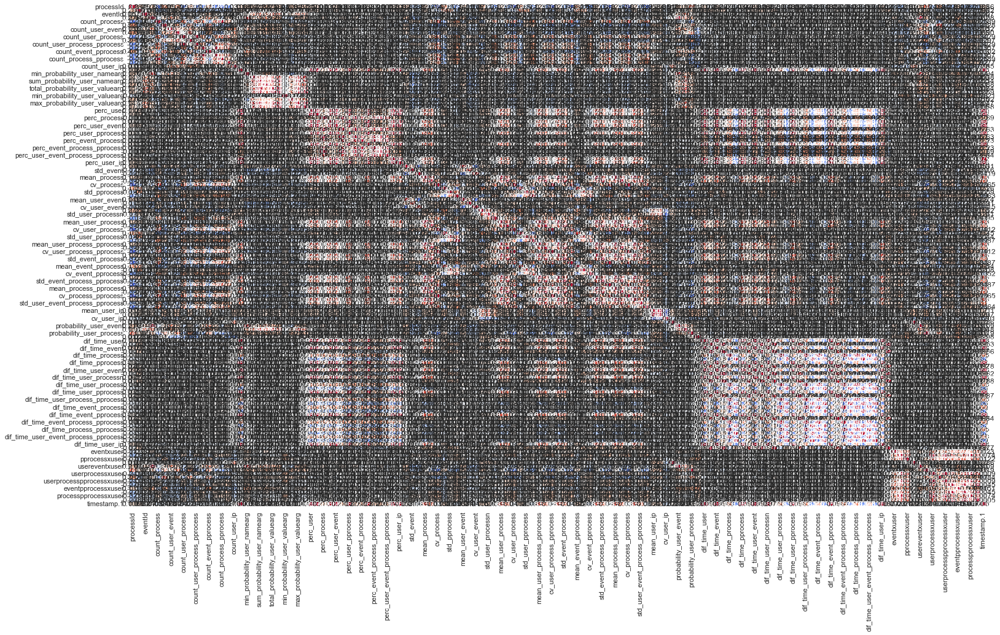

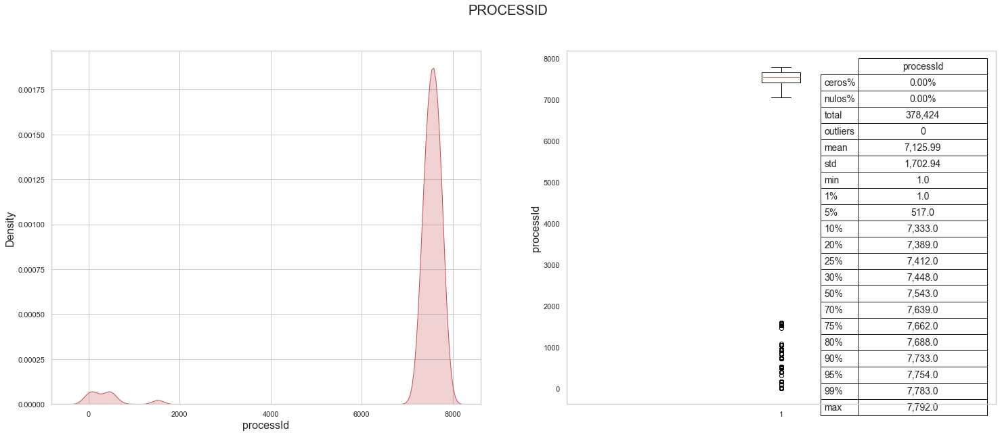

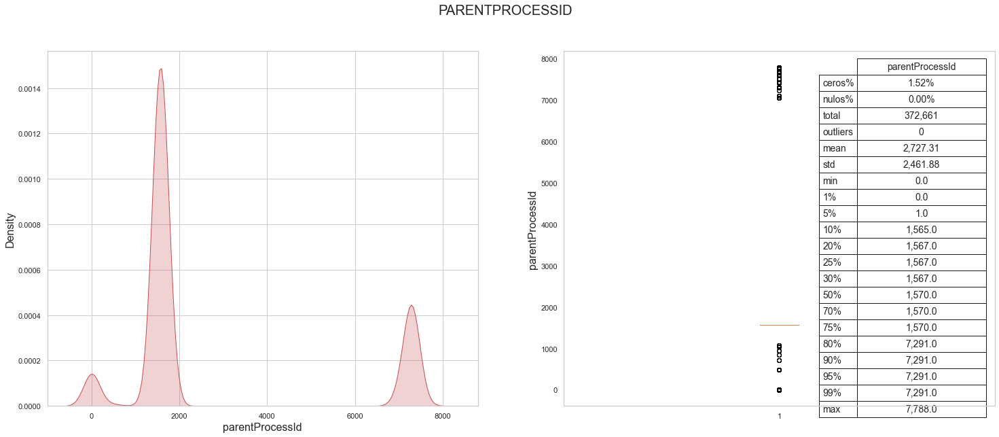

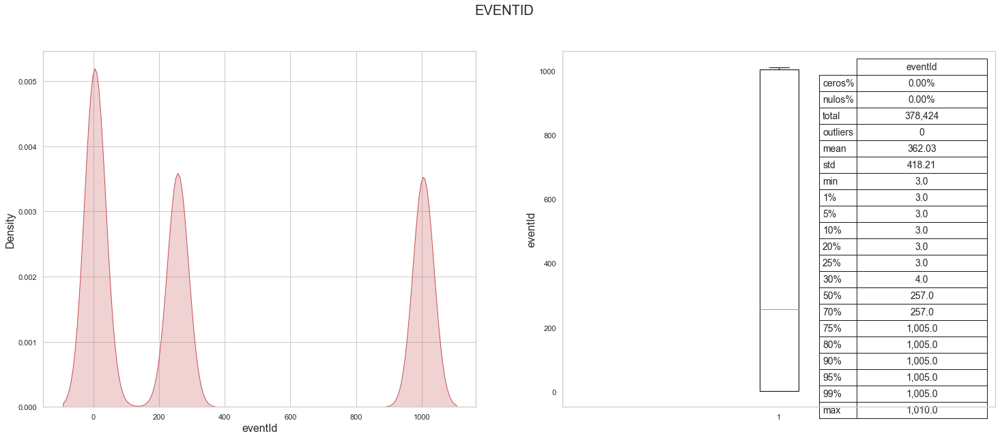

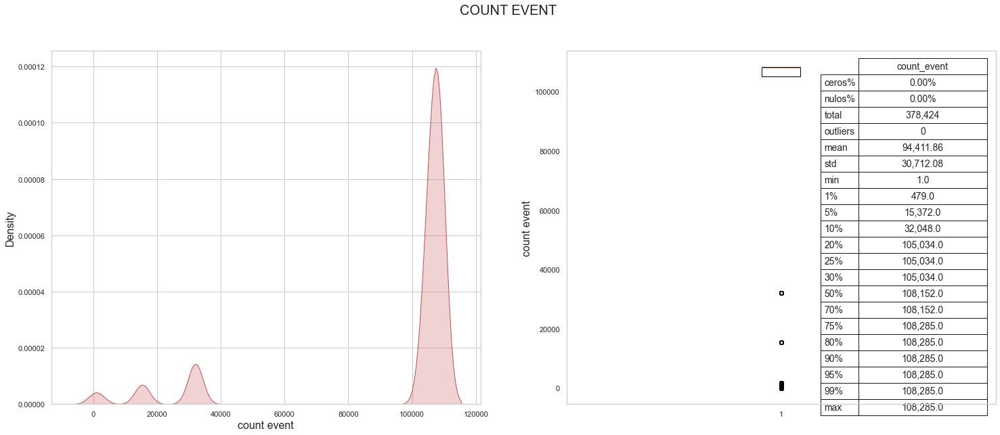

...

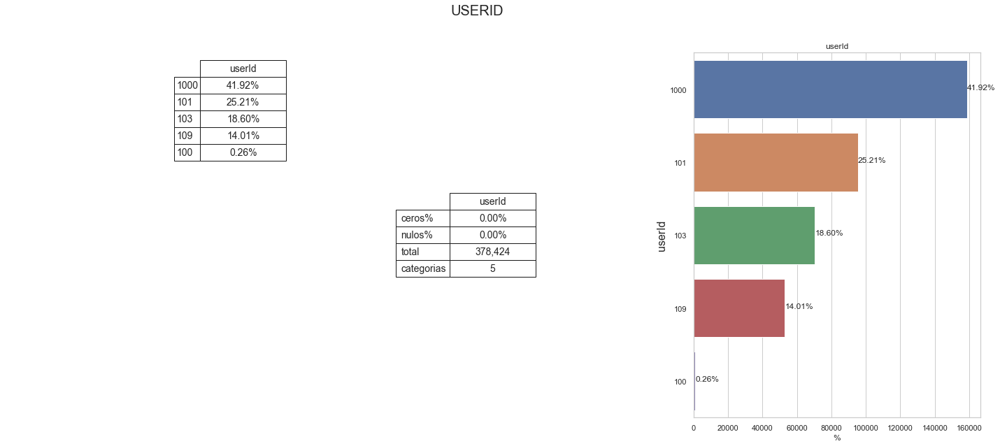

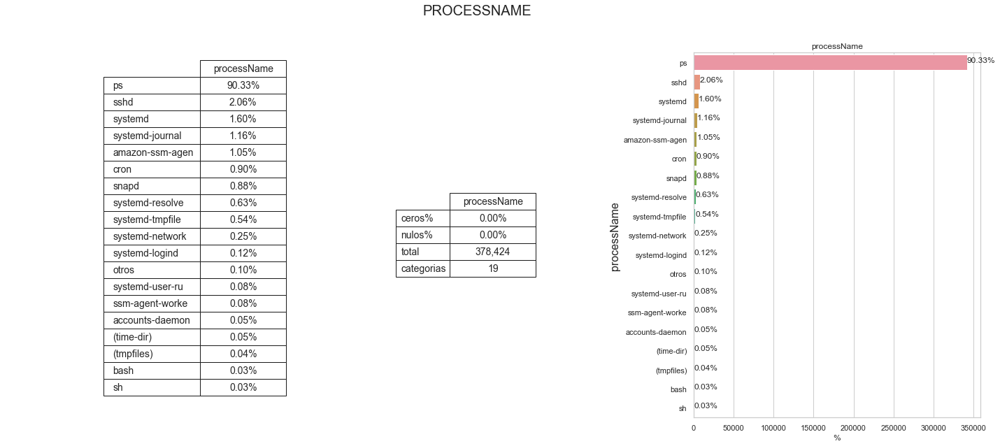

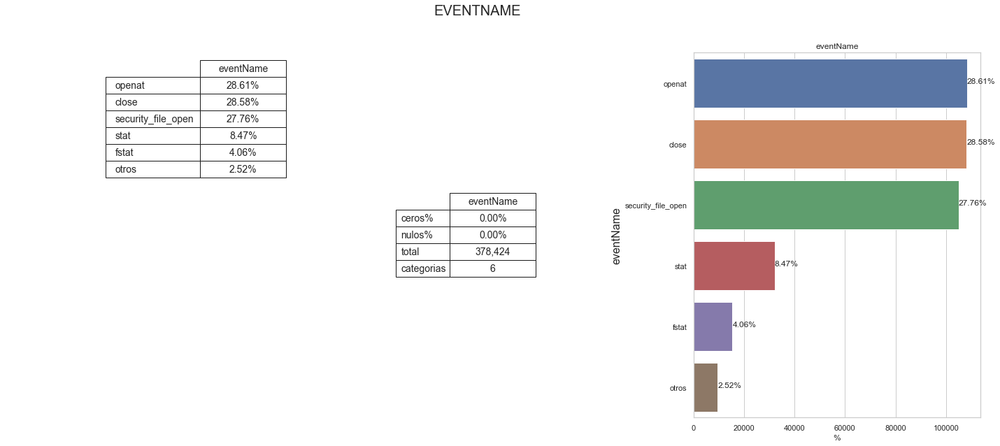

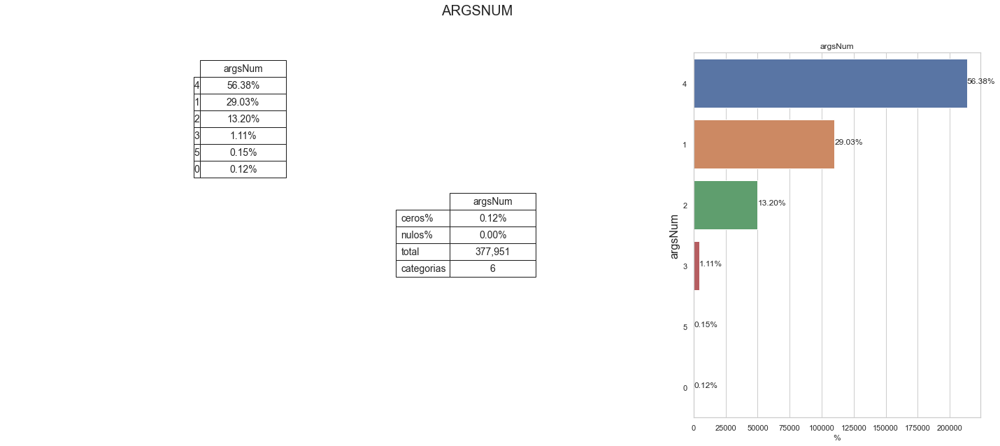

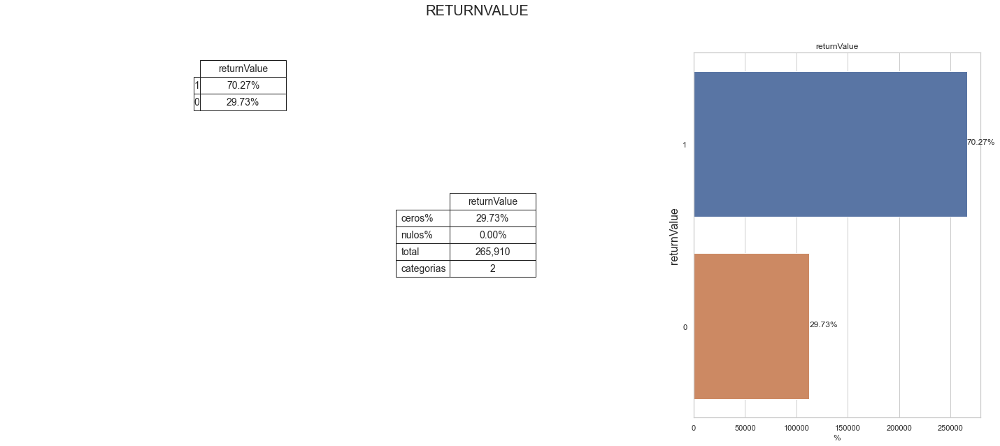

c:\ProgramData\Anaconda3\lib\site-packages\matplotlib\backends\backend_agg.py:240: RuntimeWarning: Glyph 65533 missing from current font.
  font.set_text(s, 0.0, flags=flags)
c:\ProgramData\Anaconda3\lib\site-packages\matplotlib\backends\backend_agg.py:240: RuntimeWarning: Glyph 65407 missing from current font.
  font.set_text(s, 0.0, flags=flags)
c:\ProgramData\Anaconda3\lib\site-packages\matplotlib\backends\backend_agg.py:240: RuntimeWarning: Glyph 65405 missing from current font.
  font.set_text(s, 0.0, flags=flags)


ValueError: Image size of 4616x4954245 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 1800x691.2 with 3 Axes>

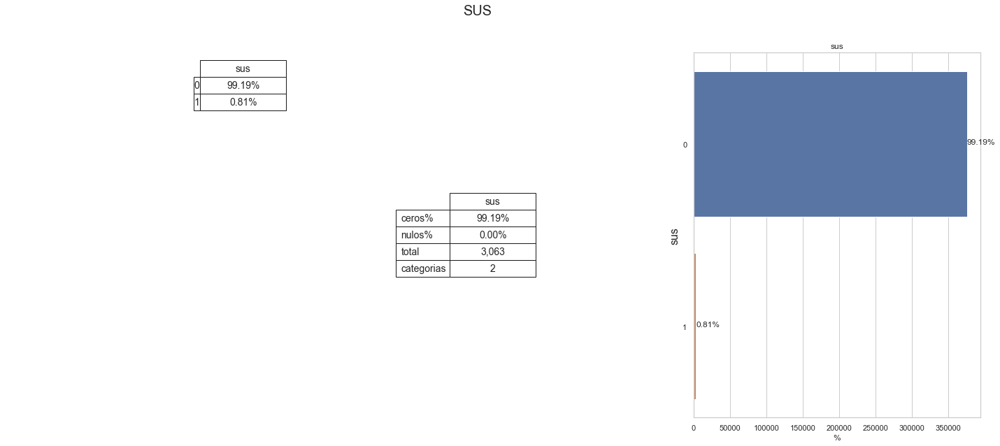

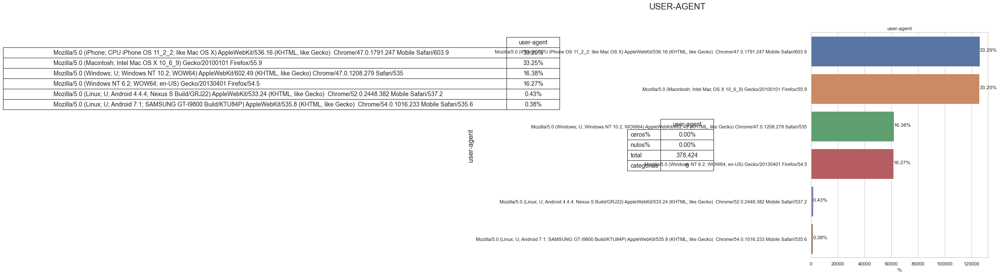

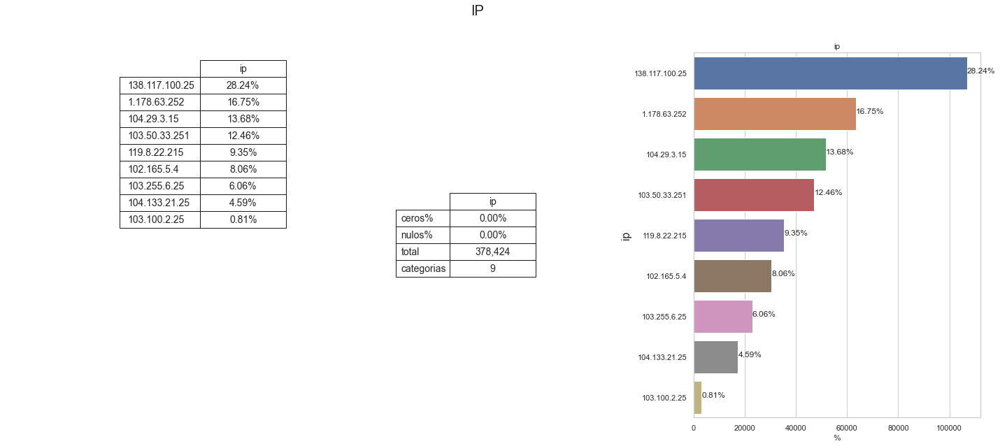

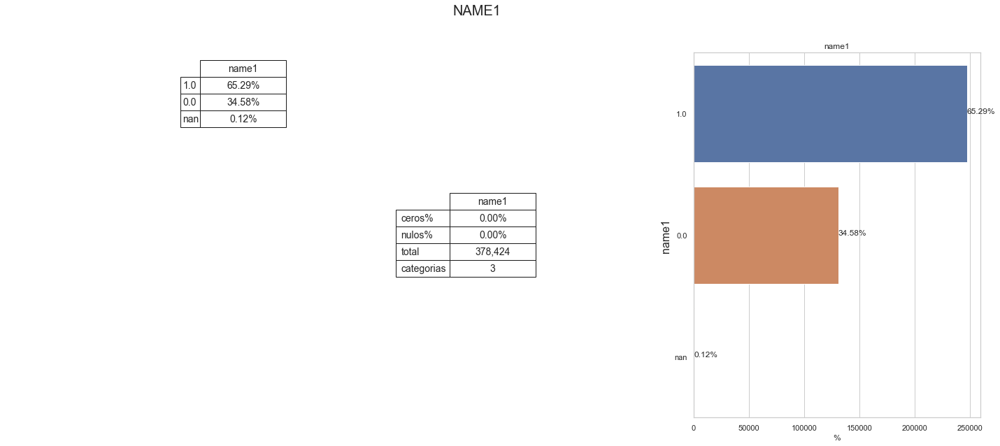

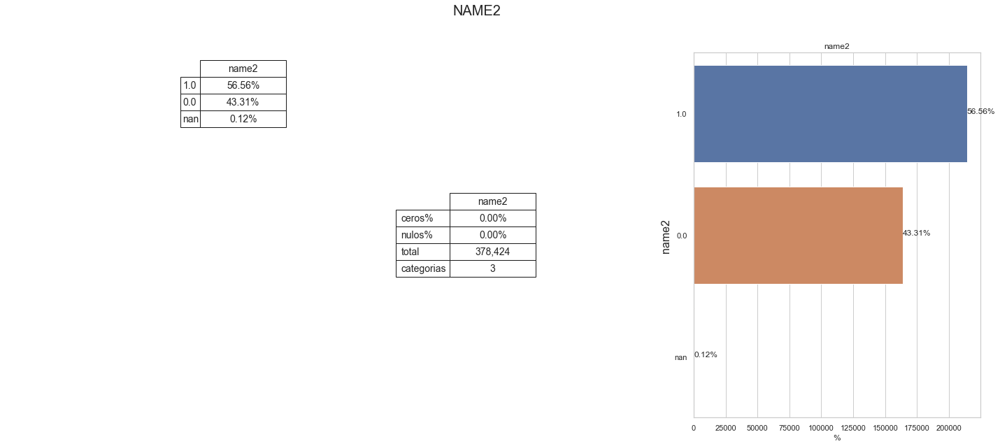

...

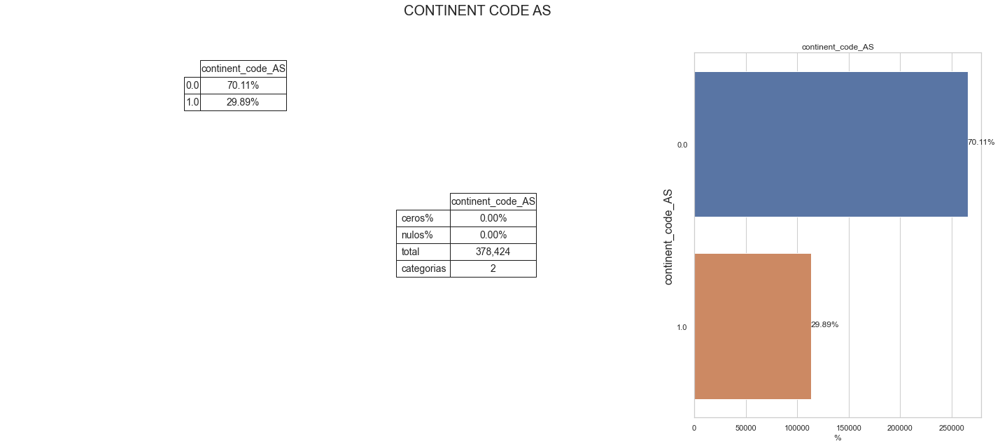

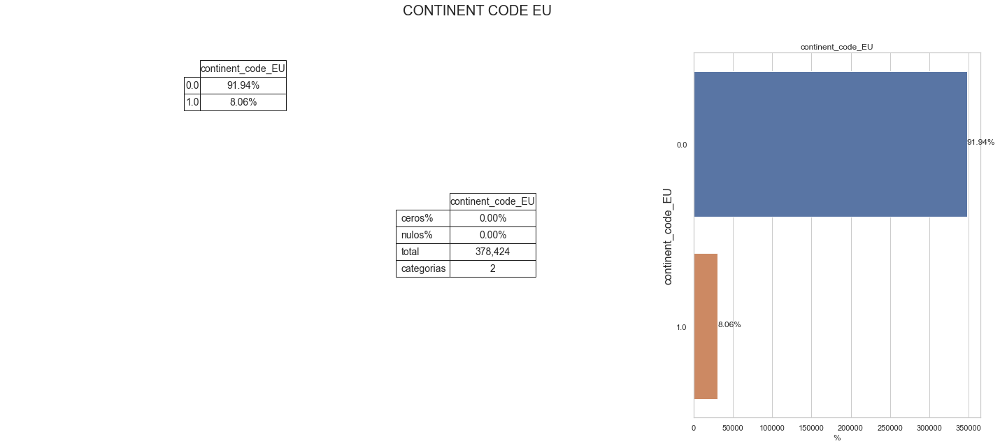

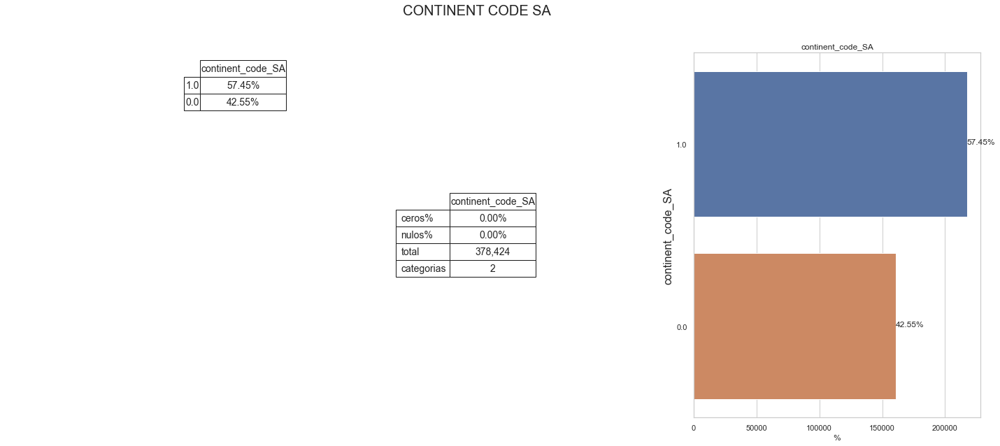

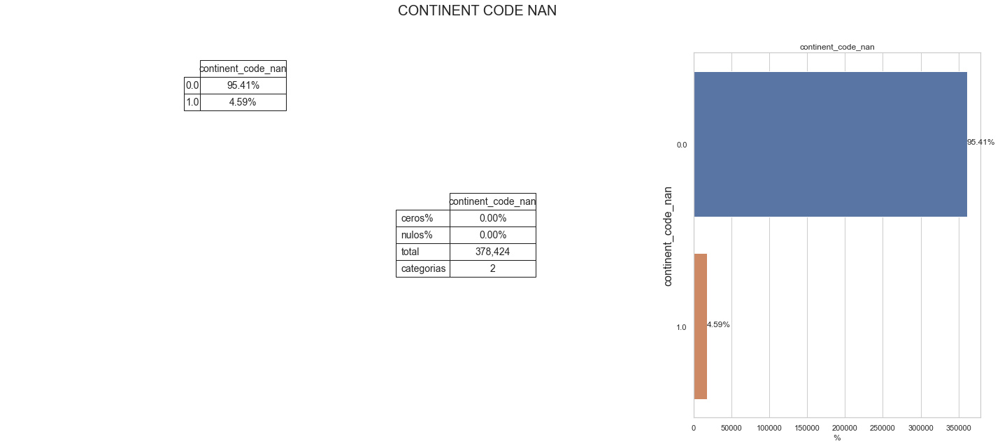

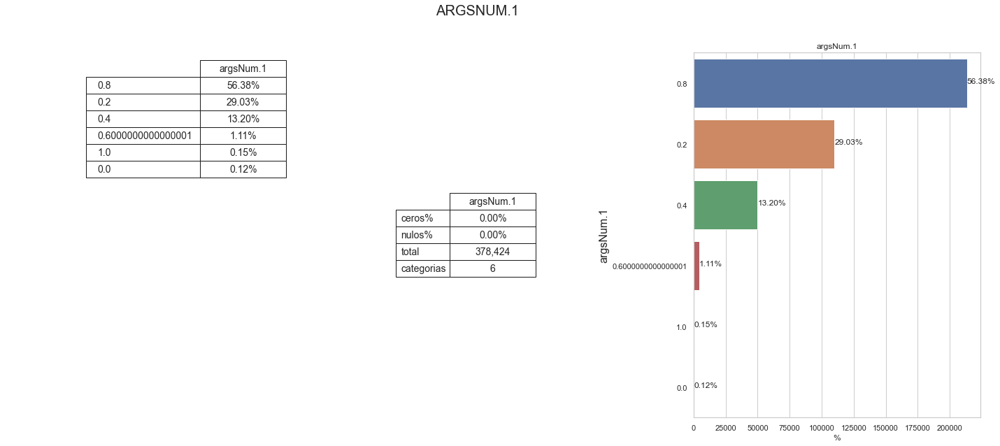

In [17]:
import matplotlib.pyplot as plt
import seaborn as sns
from pandas.plotting import table
zeros = 0
quantiles = [0.01, 0.05, 0.1, 0.2, 0.25, 0.3, 0.5, 0.7, 0.75, 0.8, 0.9, 0.95, 0.99]

descriptivo_inicial(data,num,cat)